## Import All Required Modules

In [1]:
from tui_cruises_data_science import RawDataReader, DataVisualization, styling, convert_time_columns, sum_columns, divide_columns, smoothen_data_reduction, si_conversion, get_city_name
from IPython.display import Image, display, HTML
import warnings
warnings.filterwarnings('ignore')
from dotenv import load_dotenv
import os

## Inspect the Data

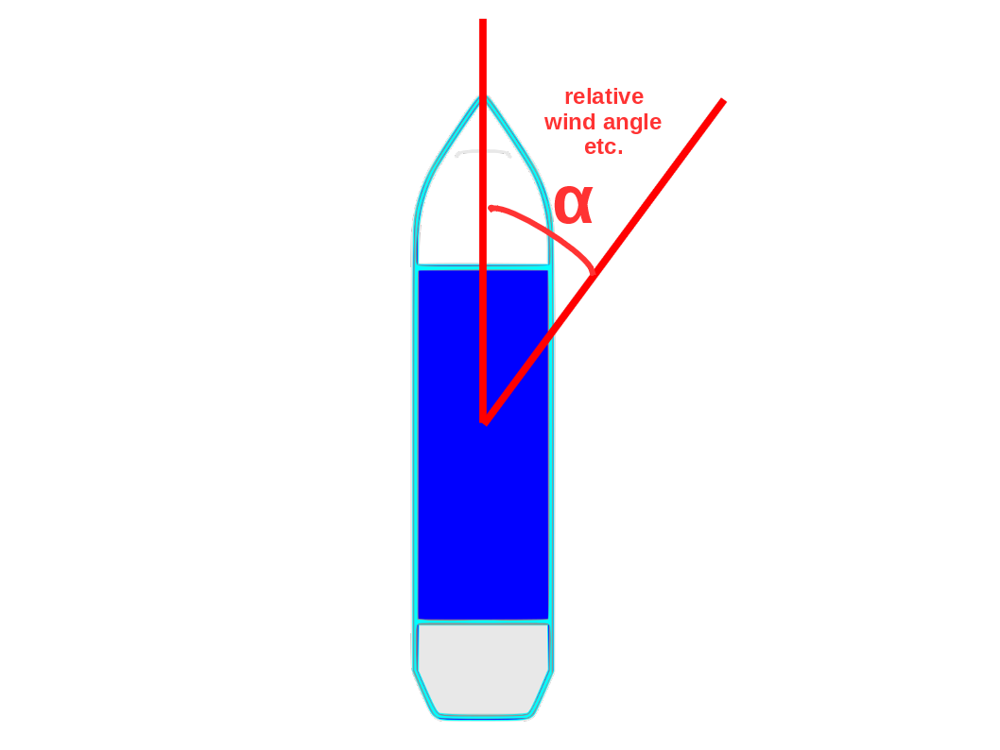

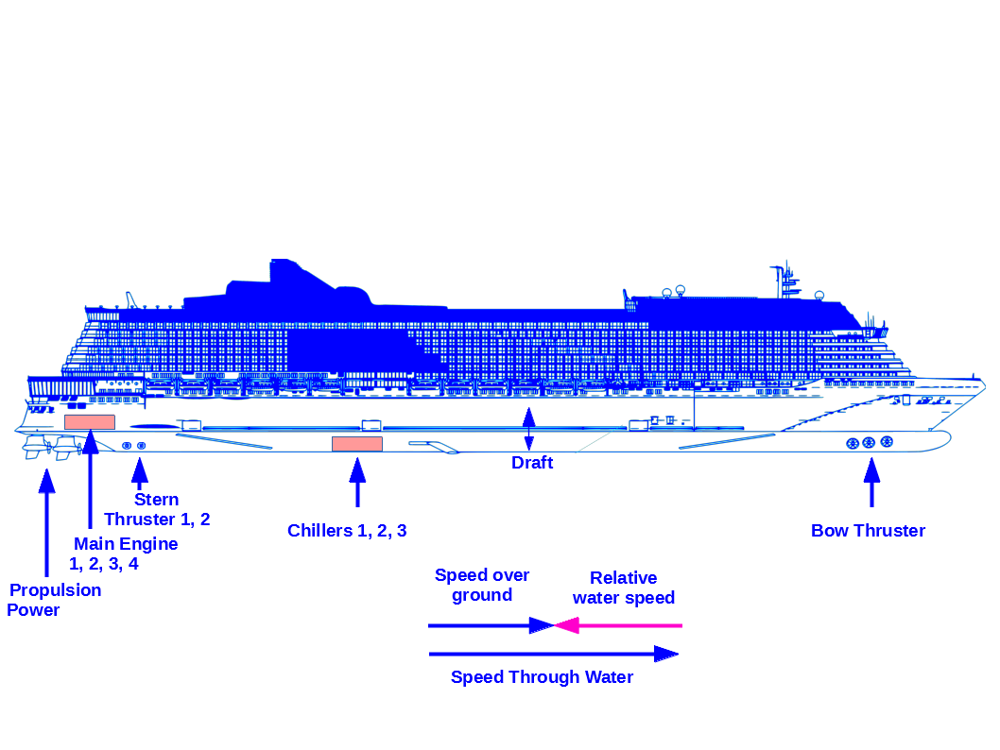

In [2]:
load_dotenv()
image_path = os.getenv("image_path")
# display(HTML(f'<img src="{image_path}ship_scheme1_ipynb.png" style="width:50%;">')) #does not work
display(Image(filename=image_path+'ship_scheme1_ipynb.png', width=500))
display(Image(filename=image_path+'ship_scheme2_ipynb.png'))


In [3]:
raw_data_obj1 = RawDataReader()

# display(df.iloc[:, [2, 18, 19]])
df = raw_data_obj1.print_rawdata_columns()
styled_df = styling(df)
display(styled_df)

,column,description
0,Start Time,Startzeit
1,End Time,Endzeit
2,Vessel Name,Schiffsname
3,Power Galley 1 (MW),"Stromkombüse, power supply no. 1"
4,Power Galley 2 (MW),-||- no. 2
5,Power Service (MW),Stromversorgung
6,HVAC Chiller 1 Power (MW),"Klimakühlgerät, cooling system no. 1"
7,HVAC Chiller 2 Power (MW),-||- no. 2
8,HVAC Chiller 3 Power (MW),-||- no. 3
9,Scrubber Power (MW),Wäscherleistung


In [4]:
df = raw_data_obj1.read_rawdata()
# styled_df = raw_data_obj1.styling(df.loc[:, ["Vessel Name", "Latitude (Degrees)"]])
# display(df.loc[:, ["Vessel Name", "Latitude (Degrees)", "Longitude (Degrees)", "Local Time (h)", "Start Time", "End Time"]])
display(df.loc[:, ["Speed Through Water (knots)", "Speed Over Ground (knots)"]])

,Speed Through Water (knots),Speed Over Ground (knots)
0,7.8881,7.6300
1,7.7438,7.5800
2,7.6320,7.4379
3,7.5080,7.3979
4,7.5521,7.4343
...,...,...
210235,4.7631,5.0814
210236,10.5515,10.3607
210237,11.6669,10.9492
210238,8.0571,7.8700


## Datetime Conversion of Startdate

In [5]:
target_column = "Start Time"
convert_time_columns(df, target_column)
display(df.loc[:, [target_column, target_column+"_norm", target_column+"_norm_total_days"]])

,Start Time,Start Time_norm,Start Time_norm_total_days
0,2023-01-01T00:00:00,2023-01-01 00:00:00,0
1,2023-01-01T00:05:00,2023-01-01 00:05:00,1
2,2023-01-01T00:10:00,2023-01-01 00:10:00,1
3,2023-01-01T00:15:00,2023-01-01 00:15:00,1
4,2023-01-01T00:20:00,2023-01-01 00:20:00,1
...,...,...,...
210235,2023-12-31T23:35:00,2023-12-31 23:35:00,365
210236,2023-12-31T23:40:00,2023-12-31 23:40:00,365
210237,2023-12-31T23:45:00,2023-12-31 23:45:00,365
210238,2023-12-31T23:50:00,2023-12-31 23:50:00,365


## Sum Up Engine and Gen Powers

### Sum Power Galleys

In [6]:
target_columns = ["Power Galley 1 (MW)", "Power Galley 2 (MW)"]
sum_column_name = "Sum Power Galleys (MW)"
df=sum_columns(df, target_columns, sum_column_name)
target_columns_all=target_columns
target_columns_all.append(sum_column_name)
display(df.loc[:, target_columns_all])

,Power Galley 1 (MW),Power Galley 2 (MW),Sum Power Galleys (MW)
0,0.0946,0.1384,0.2330
1,0.0540,0.1370,0.1910
2,0.0439,0.1785,0.2224
3,0.0733,0.1725,0.2458
4,0.0780,0.1397,0.2177
...,...,...,...
210235,0.0229,0.1796,0.2025
210236,0.0437,0.1972,0.2409
210237,0.0573,0.2030,0.2603
210238,0.0671,0.1641,0.2312


### Sum HVAC Chillers

In [7]:
target_columns = ["HVAC Chiller 1 Power (MW)", "HVAC Chiller 2 Power (MW)", "HVAC Chiller 3 Power (MW)"]
sum_column_name = "Sum HVAC Chillers (MW)"
df=sum_columns(df, target_columns, sum_column_name)
target_columns_all=target_columns
target_columns_all.append(sum_column_name)
display(df.loc[:, target_columns_all])

,HVAC Chiller 1 Power (MW),HVAC Chiller 2 Power (MW),HVAC Chiller 3 Power (MW),Sum HVAC Chillers (MW)
0,0.5074,0.0000,0.4979,1.0053
1,0.5158,0.0000,0.4982,1.0140
2,0.5117,0.0000,0.5032,1.0149
3,0.5177,0.0000,0.5103,1.0280
4,0.5169,0.0000,0.5100,1.0269
...,...,...,...,...
210235,0.5864,0.5778,0.0000,1.1642
210236,0.5829,0.5768,0.0000,1.1597
210237,0.5852,0.5779,0.0000,1.1631
210238,0.5880,0.5692,0.0000,1.1572


### Sum Boiler Fuel Flow Rates

In [8]:
target_columns = ["Boiler 1 Fuel Flow Rate (L/h)", "Boiler 1 Fuel Flow Rate (L/h)"]
sum_column_name = "Sum Boiler Fuel Flow Rates (L/h)"
df=sum_columns(df, target_columns, sum_column_name)
target_columns_all=target_columns
target_columns_all.append(sum_column_name)
display(df.loc[:, target_columns_all])

,Boiler 1 Fuel Flow Rate (L/h),Boiler 1 Fuel Flow Rate (L/h),Sum Boiler Fuel Flow Rates (L/h)
0,0.0000,0.0000,0.0000
1,47.7695,47.7695,95.5390
2,77.2034,77.2034,154.4068
3,60.6369,60.6369,121.2738
4,55.2184,55.2184,110.4368
...,...,...,...
210235,0.0000,0.0000,0.0000
210236,0.0000,0.0000,0.0000
210237,150.4140,150.4140,300.8280
210238,196.4780,196.4780,392.9560


### Sum Diesel Power Generators

In [9]:
target_columns = ["Diesel Generator 1 Power (MW)", "Diesel Generator 2 Power (MW)", "Diesel Generator 3 Power (MW)", "Diesel Generator 4 Power (MW)"]
sum_column_name = "Sum Diesel Power Generators (MW)"
df=sum_columns(df, target_columns, sum_column_name)
target_columns_all=target_columns
target_columns_all.append(sum_column_name)
display(df.loc[:, target_columns_all])

,Diesel Generator 1 Power (MW),Diesel Generator 2 Power (MW),Diesel Generator 3 Power (MW),Diesel Generator 4 Power (MW),Sum Diesel Power Generators (MW)
0,0.0000,0.0,0.0,7.3349,7.3349
1,0.0000,0.0,0.0,7.3011,7.3011
2,0.0000,0.0,0.0,7.3299,7.3299
3,0.0000,0.0,0.0,7.3712,7.3712
4,0.0000,0.0,0.0,7.3032,7.3032
...,...,...,...,...,...
210235,5.1231,0.0,0.0,3.4047,8.5278
210236,7.8241,0.0,0.0,5.1891,13.0132
210237,3.5237,0.0,0.0,3.6171,7.1408
210238,0.0000,0.0,0.0,6.6933,6.6933


### Sum Bow Thruster Powers

In [10]:
target_columns = ["Bow Thruster 1 Power (MW)", "Bow Thruster 2 Power (MW)", "Bow Thruster 3 Power (MW)"]
sum_column_name = "Sum Bow Thruster Powers (MW)"
df = sum_columns(df, target_columns, sum_column_name)
target_columns_all=target_columns
target_columns_all.append(sum_column_name)
display(df.loc[:, target_columns_all])

,Bow Thruster 1 Power (MW),Bow Thruster 2 Power (MW),Bow Thruster 3 Power (MW),Sum Bow Thruster Powers (MW)
0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0
...,...,...,...,...
210235,0.0,0.0,0.0,0.0
210236,0.0,0.0,0.0,0.0
210237,0.0,0.0,0.0,0.0
210238,0.0,0.0,0.0,0.0


### Sum Stern Thruster Powers

In [11]:
target_columns = ["Stern Thruster 1 Power (MW)", "Stern Thruster 2 Power (MW)"]
sum_column_name = "Sum Stern Thruster Powers (MW)"
df = sum_columns(df, target_columns, sum_column_name)
target_columns_all=target_columns
target_columns_all.append(sum_column_name)
display(df.loc[:, target_columns_all])

,Stern Thruster 1 Power (MW),Stern Thruster 2 Power (MW),Sum Stern Thruster Powers (MW)
0,0.0,0.0,0.0
1,0.0,0.0,0.0
2,0.0,0.0,0.0
3,0.0,0.0,0.0
4,0.0,0.0,0.0
...,...,...,...
210235,0.0,0.0,0.0
210236,0.0,0.0,0.0
210237,0.0,0.0,0.0
210238,0.0,0.0,0.0


### Sum Main Engine Fuel Flow Rates

In [12]:
target_columns = ["Main Engine 1 Fuel Flow Rate (kg/h)", "Main Engine 2 Fuel Flow Rate (kg/h)", "Main Engine 3 Fuel Flow Rate (kg/h)", "Main Engine 4 Fuel Flow Rate (kg/h)"]
sum_column_name = "Sum Main Engine Fuel Flow Rate (kg/h)"
df = sum_columns(df, target_columns, sum_column_name)
target_columns_all=target_columns
target_columns_all.append(sum_column_name)
display(df.loc[:, target_columns_all])

,Main Engine 1 Fuel Flow Rate (kg/h),Main Engine 2 Fuel Flow Rate (kg/h),Main Engine 3 Fuel Flow Rate (kg/h),Main Engine 4 Fuel Flow Rate (kg/h),Sum Main Engine Fuel Flow Rate (kg/h)
0,0.00000,0.0000,0.0,1645.82000,1645.82000
1,0.00000,0.0000,0.0,1643.78999,1643.78999
2,0.00000,0.0000,0.0,1642.07000,1642.07000
3,0.00000,0.0000,0.0,1650.71000,1650.71000
4,0.00000,0.0000,0.0,1644.54000,1644.54000
...,...,...,...,...,...
210235,1118.89100,0.0000,0.0,866.34200,1985.23300
210236,1674.12999,0.0000,0.0,1184.17999,2858.30998
210237,854.81820,0.0000,0.0,867.31000,1722.12820
210238,62.72500,0.0000,0.0,1479.74000,1542.46500


### Accumulated Main Engine Fuel Flow Rate vs. Speed Over Ground

Main Engine Fuel Flow Rate vs. Speed Over Ground is physically meaningful since it computes the fuel consumption per travelled meter.

Compute conversion factor for SI-units:
$$ 1 \ \frac{\rm kg}{{\rm h} \ \cdot \ {\rm kn}} = 1 \ \frac{\rm kg}{{\rm 3600 s} \ \cdot \ {\rm 0.514444 \ m/s}} = 5.3996 \cdot 10^{-4} \ \frac{\rm kg}{\rm m}$$

kn: abbreviation for "knots"

In [13]:
target_columns = ["Sum Main Engine Fuel Flow Rate (kg/h)", "Speed Over Ground (knots)"]
divide_column_name = "Main Rate / Speed (kg/(h*knots))"

df = divide_columns(df, target_columns, divide_column_name)

source_column_name = "Main Rate / Speed (kg/(h*knots))"
si_column_name = "Main Rate / Speed (kg/m)"
si_conversion_factor = 5.3996e-4
df = si_conversion(df, source_column_name, si_column_name, si_conversion_factor)
target_columns_all=target_columns
target_columns_all.append(divide_column_name)
target_columns_all.append(si_column_name)
display(df.loc[:, target_columns_all])

,Sum Main Engine Fuel Flow Rate (kg/h),Speed Over Ground (knots),Main Rate / Speed (kg/(h*knots)),Main Rate / Speed (kg/m)
0,1645.82000,7.6300,215.703801,0.116471
1,1643.78999,7.5800,216.858838,0.117095
2,1642.07000,7.4379,220.770648,0.119207
3,1650.71000,7.3979,223.13224,0.120482
4,1644.54000,7.4343,221.209798,0.119444
...,...,...,...,...
210235,1985.23300,5.0814,390.686228,0.210955
210236,2858.30998,10.3607,275.880006,0.148964
210237,1722.12820,10.9492,157.283473,0.084927
210238,1542.46500,7.8700,195.993011,0.105828


## Vessel 1

### Geotrack of Vessel 1

In [14]:
import branca
import folium
import matplotlib.pyplot as plt
import pandas as pd

### Geotrack of Vessel 1 (CONSISTENCY TEST)

CONSISTENCY TEST

Goal: First step...Comprehending the route taken by the vessel in relative days (0 to 365, i.e. 1 year)

In [15]:
visualization_obj1 = DataVisualization()

condition = df['Vessel Name'] == 'Vessel 1'
lat_list = df.loc[condition, 'Latitude (Degrees)'].tolist()
long_list = df.loc[condition, 'Longitude (Degrees)'].tolist()
days_list = df.loc[condition, 'Start Time_norm_total_days'].tolist()
data_vessel1 = {
    'latitude': lat_list[:],
    'longitude': long_list[:],
    'days_list': days_list[:]
}

df_vessel1 = pd.DataFrame(data_vessel1)
df_vessel1_dropna = df_vessel1.dropna()
df_vessel1_dropna['coordinates'] = df_vessel1_dropna.apply(lambda row: (row['latitude'], row['longitude']), axis=1)
visualization_obj1.map_x_y(df_vessel1_dropna, cmap = "jet",
                           cmap_title = "Time Progression [relative days]",
                           color_representation = "days_list",
                           zoom_control = False)

Conclusion: Vessel 1 obviously started in the caribbean sea and was driven to somewhere south of Portugal at the end of the year...

### Plot Sea Temperature (CONSISTENCY TEST)

CONSISTENCY TEST to show, if the color representation returns consistent results

In [16]:
visualization_obj1 = DataVisualization()

condition = df['Vessel Name'] == 'Vessel 1'

lat_list = df.loc[condition, 'Latitude (Degrees)'].tolist()
long_list = df.loc[condition, 'Longitude (Degrees)'].tolist()
sea_temp_list = df.loc[condition, 'Sea Temperature (Celsius)'].tolist()
data_vessel1 = {
    'latitude': lat_list[:],
    'longitude': long_list[:],
    'sea_temp_list': sea_temp_list[:]
}

df_vessel1 = pd.DataFrame(data_vessel1)
df_vessel1_dropna = df_vessel1.dropna()
df_vessel1_dropna['coordinates'] = df_vessel1_dropna.apply(lambda row: (row['latitude'], row['longitude']), axis=1)
visualization_obj1.map_x_y(df_vessel1_dropna,
                           cmap = "jet",
                           granularity = 20,
                           color_representation = "sea_temp_list",
                           cmap_title = "Sea Temperature [°C]",
                           zoom_control = False)

### Plot Accumulated Main Engine Fuel Flow Rate

goal: where are the most fuel-consuming geospots?

$$ S_{\rm fuel\ rate\ main}(t) = \sum\limits_1^4 r_i(t) $$
where $ S_{\rm frm}(t) $ is the current accumulated fuel rate (frm: fuel rate main) of all 4 main engines for each time $t$.

In [17]:
visualization_obj1 = DataVisualization()

condition = df['Vessel Name'] == 'Vessel 1'

lat_list = df.loc[condition, 'Latitude (Degrees)'].tolist()
long_list = df.loc[condition, 'Longitude (Degrees)'].tolist()
sum_main_engine = df.loc[condition, 'Sum Main Engine Fuel Flow Rate (kg/h)'].tolist()
data_vessel1 = {
    'latitude': lat_list[:],
    'longitude': long_list[:],
    'sum_main_engine': sum_main_engine[:]
}

df_vessel1 = pd.DataFrame(data_vessel1)
df_vessel1_dropna = df_vessel1.dropna()
df_vessel1_dropna['coordinates'] = df_vessel1_dropna.apply(lambda row: (row['latitude'], row['longitude']), axis=1)
visualization_obj1.map_x_y(df_vessel1_dropna,
                           cmap = "jet",
                           granularity = 20,
                           color_representation = "sum_main_engine",
                           cmap_title = "Sum Main Engine Fuel Flow Rate (kg/h)",
                           zoom_control = False)

conclusion: main engine fuel consumption reaches max somewhere in southern Norway. Just from this consumption point of view maybe a different route could be chosen...however, for a more detailed analysis, one has to take into account many other aspects:
- season
- relative and overground speed: forces applied by water flow, hydrodynamics etc...
- wind (relative angles & speed) converted to physical friction forces
- the ocean's flow dynamics / profiles (-> are time-resolved datasets from NASA or Alfred Wegener institute available?)

### Plot Accumulated Main Engine Fuel Flow Rate vs. Speed Over Ground

goal: where is the most inefficient progress over ground?

$$ x(t) = \frac{\sum\limits_{i=1}^4 r_i(t)}{v(t)} $$

Inspection of Data in line plot...main_engine_fuel_consumption vs ground speed...Data are quite fluctuating, i.e. two possibilities:
- apply smoothening filter (sliding window computing mean, Gaussian filter would be an alternative)
- plot data on logscale

plot: I just used a semilog y-axis scale. One can see, that the data are vastly varying.

In [18]:
visualization_obj1 = DataVisualization()

condition = df['Vessel Name'] == 'Vessel 1'

lat_list = df.loc[condition, 'Latitude (Degrees)'].tolist()
long_list = df.loc[condition, 'Longitude (Degrees)'].tolist()
start_time_norm = df.loc[condition, 'Start Time_norm_total_days'].tolist()
# main_engine_vs_speed = df.loc[condition, 'Main Rate / Speed (kg/(h*knots))'].tolist()
main_engine_vs_speed = df.loc[condition, "Main Rate / Speed (kg/m)"].tolist()

print(len(main_engine_vs_speed))
data_vessel1 = {
    'latitude': lat_list[:],
    'longitude': long_list[:],
    'start_time_norm': start_time_norm[:],
    'main_engine_vs_speed': main_engine_vs_speed[:]
}

del df_vessel1

df_vessel1 = pd.DataFrame(data_vessel1)
df_vessel1_dropna = df_vessel1.dropna()
# df_vessel1_dropna['coordinates'] = df_vessel1_dropna.apply(lambda row: (row['latitude'], row['longitude']), axis=1)
df_vessel1_dropna.reset_index(inplace=True)


# df_tmp = smoothen_data_reduction(df_vessel1_dropna, 100) #compute means of sliding windows
df_tmp = df_vessel1_dropna

display(df_tmp)

print(df_tmp['main_engine_vs_speed'].max())
# fig = visualization_obj1.plot_x_semiy(df_tmp['start_time_norm'], df_tmp["main_engine_vs_speed"], title="semilog (main_engine_vs_speed) vs relative days", xaxis_title="relative days", yaxis_title="sum_main_engine/speed in [kg/(h*knots)]")
fig = visualization_obj1.plot_x_semiy(df_tmp['start_time_norm'], df_tmp["main_engine_vs_speed"], title="semilog (main_engine_vs_speed) vs relative days", xaxis_title="relative days", yaxis_title="Main Fuel Rate / Over Ground Speed [kg/m]")



########################################################################
# define arbitrary threshold where the fuel rate becomes "untolerable" #
########################################################################
threshold = 0.16
fig.add_shape(
    type="line",
    x0=0, x1=1,
    y0=threshold, y1=threshold,
    xref='paper',
    yref='y',
    line=dict(color="Red", width=2, dash="dashdot"),
)

fig.show()

105120


,index,latitude,longitude,start_time_norm,main_engine_vs_speed
0,0,17.72523,-65.45738,0,0.116471
1,1,17.73088,-65.44803,1,0.117095
2,2,17.73655,-65.43887,1,0.119207
3,3,17.74202,-65.42980,1,0.120482
4,4,17.74713,-65.42042,1,0.119444
...,...,...,...,...,...
77751,105115,32.63454,-16.90584,365,12.099871
77752,105116,32.63454,-16.90575,365,6.372243
77753,105117,32.63455,-16.90544,365,3.999697
77754,105118,32.63454,-16.90511,365,3.650706


6881.968386799999


In [19]:
df_filtered = df_tmp[df_tmp['main_engine_vs_speed'] > threshold]
df_filtered['coordinates'] = df_filtered.apply(lambda row: (row['latitude'], row['longitude']), axis=1)
df_filtered.reset_index(inplace=True)
display(df_filtered)

,level_0,index,latitude,longitude,start_time_norm,main_engine_vs_speed,coordinates
0,88,88,18.41558,-64.60561,1,0.200435,"(18.41558, -64.60561)"
1,89,89,18.41938,-64.60966,1,0.371856,"(18.41938, -64.60966)"
2,90,90,18.42078,-64.61180,1,0.936327,"(18.42078, -64.6118)"
3,91,91,18.42155,-64.61266,1,1.908157,"(18.42155, -64.61266)"
4,92,92,18.42186,-64.61293,1,5.009008,"(18.42186, -64.61293)"
...,...,...,...,...,...,...,...
8609,77751,105115,32.63454,-16.90584,365,12.099871,"(32.63454, -16.90584)"
8610,77752,105116,32.63454,-16.90575,365,6.372243,"(32.63454, -16.90575)"
8611,77753,105117,32.63455,-16.90544,365,3.999697,"(32.63455, -16.90544)"
8612,77754,105118,32.63454,-16.90511,365,3.650706,"(32.63454, -16.90511)"


Now plot most inefficient spots (Fuel consuption per meter)

In [20]:
visualization_obj1.map_x_y_z_peaks(df_filtered,
                                   zoom_control = False)

conclusion:

- The most "inefficient" spots accoring to this measure are - of course - all ports where the vessel just consumes fuel but stays in place.
- In addition to that, routes close to the sea shores (e.g. English Channel, but also routes close to Norway and Island) can be recognized in this analysis

### Analysis of Bow and Stern Thruster, When Do They Swing in Action?

In [21]:
visualization_obj1 = DataVisualization()

condition = df['Vessel Name'] == 'Vessel 1'

lat_list = df.loc[condition, 'Latitude (Degrees)'].tolist()
long_list = df.loc[condition, 'Longitude (Degrees)'].tolist()
start_time_norm = df.loc[condition, 'Start Time_norm'].tolist()
days_list = df.loc[condition, 'Start Time_norm_total_days'].tolist()
sum_bow_thrusters = df.loc[condition, 'Sum Bow Thruster Powers (MW)'].tolist()
sum_stern_thrusters = df.loc[condition, 'Sum Stern Thruster Powers (MW)'].tolist()
fuel_consumption = df.loc[condition, "Sum Main Engine Fuel Flow Rate (kg/h)"].tolist()

data_vessel1 = {
    'latitude': lat_list[:],
    'longitude': long_list[:],
    'start_time_norm': start_time_norm[:],
    'days_list': days_list[:],
    'sum_bow_thrusters': sum_bow_thrusters[:],
    'sum_stern_thrusters': sum_stern_thrusters[:],
    'fuel_consumption': fuel_consumption[:]
}

df_vessel1 = pd.DataFrame(data_vessel1)
df_vessel1_dropna = df_vessel1.dropna()

lower_limit="2023-01-01 00:00:00"
# upper_limit="2023-01-16 00:00:00"
upper_limit="2023-01-15 12:00:00"
df_vessel1_limited = df_vessel1_dropna[(df_vessel1_dropna['start_time_norm'] >= lower_limit) & (df_vessel1_dropna['start_time_norm'] <= upper_limit)]
df_vessel1_limited['coordinates'] = df_vessel1_limited.apply(lambda row: (row['latitude'], row['longitude']), axis=1)

fig = visualization_obj1.plot_x_y(df_vessel1_limited['start_time_norm'], df_vessel1_limited["sum_bow_thrusters"], title="sum bow thrusters [MW] vs date", xaxis_title="date", yaxis_title="sum bow thrusters [MW]")
fig.show()

fig = visualization_obj1.plot_x_y(df_vessel1_limited['start_time_norm'], df_vessel1_limited["sum_stern_thrusters"], title="sum stern thrusters [MW] vs date", xaxis_title="date", yaxis_title="sum stern thrusters [MW]")
fig.show() # bow and stern thrusters should be integrated into one plot...easy, but no time

fig = visualization_obj1.plot_x_y(df_vessel1_limited['start_time_norm'], df_vessel1_limited["fuel_consumption"], title="fuel_consumption", xaxis_title="date", yaxis_title="fuel_consumption main engine [kg/h]")
fig.show()

visualization_obj1.map_x_y(df_vessel1_limited, cmap = "jet",
                           cmap_title = "Time Progression [relative days]",
                           color_representation = "days_list",
                           zoom_control = False)

conclusion:
- bow and stern thrusters seem to be used only at ports!
- in between two consecutive peaks of bow or stern thrusters the ship is most likely in a port

Lets check out, if the cityname of the destination port at the current position with latitude=53.55574 and longitude=8.55649 can be obtained by a geopy query...

In [22]:
last_row = df_vessel1_limited.iloc[-1]
print(last_row)

latitude                          53.55574
longitude                          8.55649
start_time_norm        2023-01-15 12:00:00
days_list                               15
sum_bow_thrusters                      0.0
sum_stern_thrusters                    0.0
fuel_consumption                    955.74
coordinates            (53.55574, 8.55649)
Name: 4176, dtype: object


In [23]:
########################################################
# # geopy-package: queries seem to be rate-limited !!! #
########################################################
latitude = 53.55574
longitude = 8.55649

city_name = get_city_name(latitude, longitude, "route_destination.txt", data_renew = False)
print(city_name)

Bremen


Conclusion: The city of the destination port is Bremen.

### Try to Get All Port Names of Routes with this Approach

In [24]:
fig = visualization_obj1.plot_x_y(df_vessel1_limited['start_time_norm'], df_vessel1_limited["sum_bow_thrusters"], title="sum bow thrusters [MW] vs date", xaxis_title="date", yaxis_title="sum bow thrusters [MW]")

threshold = 1
fig.add_shape(
    type="line",
    x0=0, x1=1,
    y0=threshold, y1=threshold,
    xref='paper',
    yref='y',
    line=dict(color="Red", width=2, dash="dashdot"),
)

fig.show()

df_filtered = df_vessel1_limited[df_vessel1_limited['sum_bow_thrusters'] > threshold]
df_filtered.reset_index(inplace=True)
display(df_filtered)

,index,latitude,longitude,start_time_norm,days_list,sum_bow_thrusters,sum_stern_thrusters,fuel_consumption,coordinates
0,265,18.41800,-64.60825,2023-01-01 22:05:00,1,1.8840,0.4982,2108.31301,"(18.418, -64.60825)"
1,266,18.41668,-64.60592,2023-01-01 22:10:00,1,3.1845,1.2199,2715.26600,"(18.41668, -64.60592)"
2,267,18.41479,-64.60522,2023-01-01 22:15:00,1,1.6351,0.4158,2408.94900,"(18.41479, -64.60522)"
3,590,17.12153,-61.84954,2023-01-03 01:10:00,3,5.3672,0.1616,1848.63299,"(17.12153, -61.84954)"
4,596,17.12218,-61.85329,2023-01-03 01:40:00,3,1.4343,0.3769,2244.84597,"(17.12218, -61.85329)"
5,653,17.12245,-61.85176,2023-01-03 06:25:00,3,1.9594,1.0962,2588.19899,"(17.12245, -61.85176)"
6,2577,28.47124,-16.24200,2023-01-09 22:45:00,9,1.0140,0.7675,1846.77699,"(28.47124, -16.242)"
7,2578,28.47202,-16.24171,2023-01-09 22:50:00,9,1.0546,0.5031,1790.66100,"(28.47202, -16.24171)"
8,2579,28.47366,-16.24114,2023-01-09 22:55:00,9,2.1322,1.1428,2099.36300,"(28.47366, -16.24114)"
9,2580,28.47519,-16.24040,2023-01-09 23:00:00,9,1.2999,1.2927,2343.07701,"(28.47519, -16.2404)"


In [25]:
list_index = df_filtered['index']
list_ind = []
tolerance_range = 70
tmp_index = 0
for curr_index, curr_value in enumerate(list_index):
        if (tmp_index > curr_value + tolerance_range) or (tmp_index < curr_value - tolerance_range):
                list_ind.append(curr_value)
                tmp_index = curr_value
print(list_ind)

df_filtered_city = df_filtered[df_filtered['index'].isin(list_ind)]
df_filtered_city.reset_index(inplace=True)


city_name_list=[]

########################################################
# # geopy-package: queries seem to be rate-limited !!! #
########################################################
print("\nPorts and Cities of the route:\n")
for curr_index in range(len(df_filtered_city["coordinates"])):
    city_name = get_city_name(df_filtered_city["latitude"][curr_index], df_filtered_city["longitude"][curr_index], "port_"+str(curr_index)+".txt", data_renew = False)
    print(str(curr_index+1) + ".", city_name)
    city_name_list.append(city_name)

df_filtered_city["city"]=city_name_list
display(df_filtered_city)
print(float(df_filtered_city["longitude"][2]))

[265, 590, 2577, 4073]

Ports and Cities of the route:

1. Road Town
2. St. John's
3. Santa Cruz de Tenerife
4. Bremen


,level_0,index,latitude,longitude,start_time_norm,days_list,sum_bow_thrusters,sum_stern_thrusters,fuel_consumption,coordinates,city
0,0,265,18.41800,-64.60825,2023-01-01 22:05:00,1,1.8840,0.4982,2108.31301,"(18.418, -64.60825)",Road Town
1,3,590,17.12153,-61.84954,2023-01-03 01:10:00,3,5.3672,0.1616,1848.63299,"(17.12153, -61.84954)",St. John's
2,6,2577,28.47124,-16.24200,2023-01-09 22:45:00,9,1.0140,0.7675,1846.77699,"(28.47124, -16.242)",Santa Cruz de Tenerife
3,10,4073,53.55981,8.54822,2023-01-15 03:25:00,15,1.2695,0.6245,1800.48200,"(53.55981, 8.54822)",Bremen


-16.242


### What is the Average Fuel Consumption per Hour on the Ocean and within the Ports?

In [28]:
fig = visualization_obj1.plot_x_y(df_vessel1_limited['start_time_norm'], df_vessel1_limited["fuel_consumption"], title="fuel_consumption", xaxis_title="date", yaxis_title="fuel_consumption main engine [kg/h]")

threshold = 1400
fig.add_shape(
    type="line",
    x0=0, x1=1,
    y0=threshold, y1=threshold,
    xref='paper',
    yref='y',
    line=dict(color="Red", width=2, dash="dashdot"),
)

fig.show()

tolerance_range=0.01
df_vessel1_limited['port_binary_column'] = (df_vessel1_limited['fuel_consumption'] < threshold).astype(int)
df_vessel1_limited['location_area'] = ["ocean"]*len(df_vessel1_limited['port_binary_column'])

filtered_df = df_vessel1_limited[df_vessel1_limited['port_binary_column'] == 1]

index_list = filtered_df.index.tolist()
for curr_value in index_list:
    for curr_index2 in range(len(df_filtered_city)):
        lat_tolerance_lower=float(df_vessel1_limited["latitude"][int(curr_value)]) > (float(df_filtered_city["latitude"][curr_index2]) - tolerance_range)
        lat_tolerance_upper=float(df_vessel1_limited["latitude"][int(curr_value)]) < (float(df_filtered_city["latitude"][curr_index2]) + tolerance_range)
        long_tolerance_lower=float(df_vessel1_limited["longitude"][int(curr_value)]) > (float(df_filtered_city["longitude"][curr_index2]) - tolerance_range)
        long_tolerance_upper=float(df_vessel1_limited["longitude"][int(curr_value)]) < (float(df_filtered_city["longitude"][curr_index2]) + tolerance_range)
        list_criteria = [lat_tolerance_lower, lat_tolerance_upper, long_tolerance_lower, long_tolerance_upper]
        if all(list_criteria):
            df_vessel1_limited['location_area'][int(curr_value)]=df_filtered_city["city"][curr_index2]
            df_vessel1_limited["port_binary_column"][int(curr_value)] = 1
        else:
            df_vessel1_limited["port_binary_column"][int(curr_value)] = 0

display(df_vessel1_limited.loc[:, ["start_time_norm", 'location_area', "port_binary_column", "latitude", "longitude", "fuel_consumption"]])

# df_vessel1_limited.to_excel("df_vessel1_limited.xlsx")

,start_time_norm,location_area,port_binary_column,latitude,longitude,fuel_consumption
0,2023-01-01 00:00:00,ocean,0,17.72523,-65.45738,1645.82000
1,2023-01-01 00:05:00,ocean,0,17.73088,-65.44803,1643.78999
2,2023-01-01 00:10:00,ocean,0,17.73655,-65.43887,1642.07000
3,2023-01-01 00:15:00,ocean,0,17.74202,-65.42980,1650.71000
4,2023-01-01 00:20:00,ocean,0,17.74713,-65.42042,1644.54000
...,...,...,...,...,...,...
4172,2023-01-15 11:40:00,Bremen,1,53.55575,8.55649,956.82700
4173,2023-01-15 11:45:00,Bremen,1,53.55574,8.55649,948.55200
4174,2023-01-15 11:50:00,Bremen,1,53.55574,8.55649,954.57900
4175,2023-01-15 11:55:00,Bremen,1,53.55574,8.55649,950.12000


goal: Computing the average fuel consumption per hour within the ports and on open ocean

$$  {\rm av}_{\rm ocean} = \sum\limits_{i=1}^{N} {\rm fuel}_{i} \Bigg|_{\rm ocean} $$

In [43]:
df_vessel1_ocean=df_vessel1_limited[df_vessel1_limited["location_area"]=="ocean"].dropna()
mean_consumption_ocean = df_vessel1_ocean["fuel_consumption"].mean()

df_vessel1_ports=df_vessel1_limited[df_vessel1_limited["location_area"]!="ocean"].dropna()
mean_consumption_ports = df_vessel1_ports["fuel_consumption"].mean()

fig = visualization_obj1.plot_x_y(df_vessel1_limited['start_time_norm'], df_vessel1_limited["fuel_consumption"], title="fuel_consumption", xaxis_title="date", yaxis_title="fuel_consumption main engine [kg/h]")

# Add a label to the line using annotations
fig.add_annotation(
    x=df_vessel1_limited['start_time_norm'][1000],
    y=threshold,
    text="threshold",
    showarrow=True,
    arrowhead=3,
    ax=0,
    ay=-40,
)

fig.add_annotation(
    x=df_vessel1_limited['start_time_norm'][1000],
    y=mean_consumption_ocean,
    text="mean_consumption_ocean",
    showarrow=True,
    arrowhead=1,
    ax=0,
    ay=-40,
)

fig.add_annotation(
    x=df_vessel1_limited['start_time_norm'][1300],
    y=mean_consumption_ports,
    text="mean_consumption_ports",
    showarrow=True,
    arrowhead=1,
    ax=0,
    ay=-40,
)

fig.add_shape(
    type="line",
    x0=0, x1=1,
    y0=threshold, y1=threshold,
    xref='paper',
    yref='y',
    line=dict(color="Red", width=2, dash="dashdot"),
)

fig.add_shape(
    type="line",
    x0=0, x1=1,
    y0=mean_consumption_ocean, y1=mean_consumption_ocean,
    xref='paper',
    yref='y',
    line=dict(color="Blue", width=2, dash="dashdot"),
)

fig.add_shape(
    type="line",
    x0=0, x1=1,
    y0=mean_consumption_ports, y1=mean_consumption_ports,
    xref='paper',
    yref='y',
    line=dict(color="Green", width=2, dash="dashdot"),
)

fig.show()

print("mean fuel consumption main engine in the ocean:\t", round(mean_consumption_ocean, 2), " [kg/h]")
print("mean fuel consumption main engine within ports:\t", round(mean_consumption_ports, 2), " [kg/h]")

mean fuel consumption main engine in the ocean:	 4169.23  [kg/h]
mean fuel consumption main engine within ports:	 1048.66  [kg/h]


### Geotrack of Vessel 2

In [24]:
visualization_obj2 = DataVisualization()

condition = df['Vessel Name'] == 'Vessel 2'
lat_list = df.loc[condition, 'Latitude (Degrees)'].tolist()
long_list = df.loc[condition, 'Longitude (Degrees)'].tolist()
data_vessel2 = {
    'latitude': lat_list[:],
    'longitude': long_list[:]
}

df_vessel2 = pd.DataFrame(data_vessel2)
df_vessel2_dropna = df_vessel2.dropna()
df_vessel2_dropna['coordinates'] = df_vessel2_dropna.apply(lambda row: (row['latitude'], row['longitude']), axis=1)
visualization_obj2.map_x_y(df_vessel2_dropna, cmap = "jet", zoom_control = False)

In [25]:
import os
os.system("jupyter nbconvert main.ipynb --to html --output ../target/main_export.html")

0